In [ ]:
!pip install h5py
!pip install typing-extensions
!pip install wheel

In [ ]:
!pip install tensorflow keras_cv --upgrade --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 475.2/475.2 MB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 606.1/606.1 kB 57.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 950.8/950.8 kB 66.1 MB/s eta 0:00:00


In [ ]:
!pip install -q --upgrade keras-cv
!pip install -q --upgrade keras==2.15.0  # Upgrade to Keras 3.

In [ ]:
import time
import keras_cv
import keras
import matplotlib.pyplot as plt

Using TensorFlow backend


In [ ]:
def plot_images(images):
    plt.figure(figsize=(18, 18))
    for i in range(len(images)):
        ax = plt.subplot(1, len(images), i + 1)
        plt.imshow(images[i])
        plt.axis("off")


By using this model checkpoint, you acknowledge that its usage is subject to the terms of the CreativeML Open RAIL-M license at https://raw.githubusercontent.com/CompVis/stable-diffusion/main/LICENSE
198180272/198180272 [==============================] - 1s 0us/step


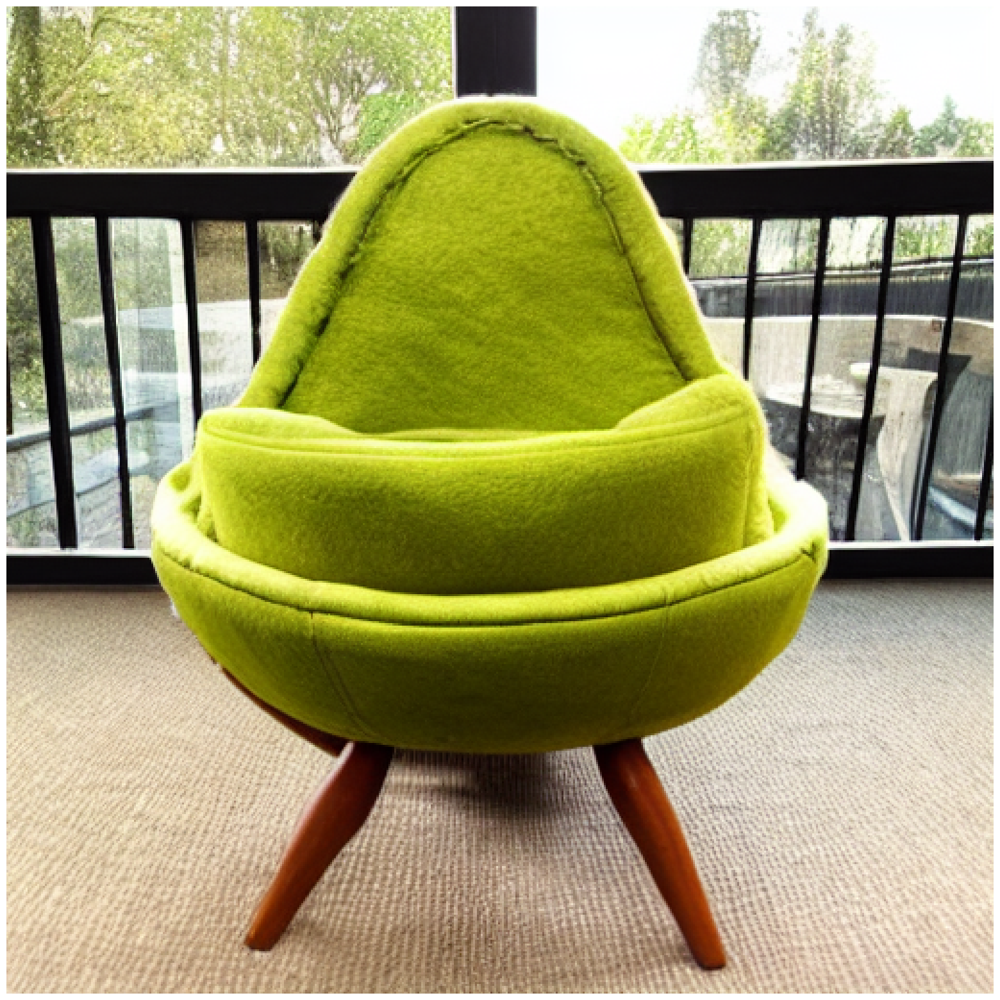

In [ ]:
# Set back to the default for benchmarking purposes.
keras.mixed_precision.set_global_policy("float16")
import tensorflow as tf
model = keras_cv.models.StableDiffusion(jit_compile=True)

# Before we benchmark the model, we run inference once to make sure the TensorFlow
# graph has already been traced.
images = model.text_to_image("An avocado armchair", batch_size=1)
plot_images(images)

50/50 [==============================] - 110s 438ms/step
With XLA: 188.04 seconds


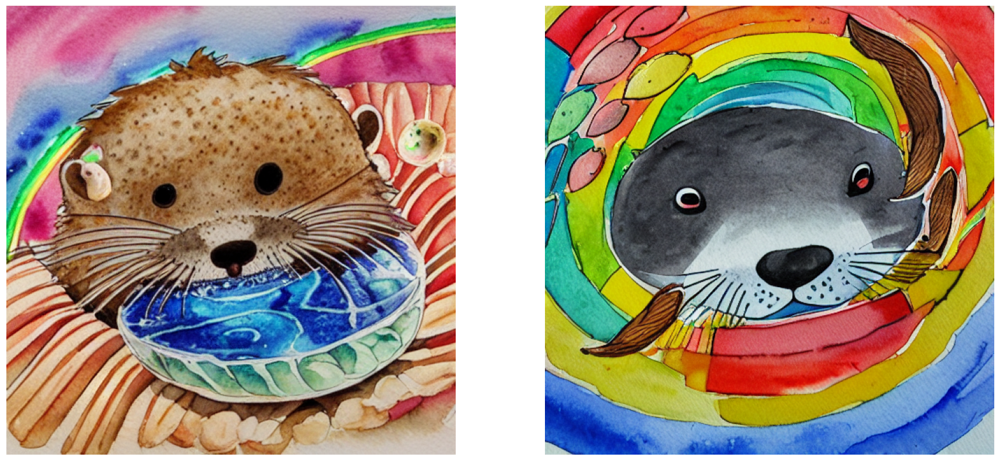

In [ ]:
benchmark_result=[]
start = time.time()
images = model.text_to_image(
    "A cute otter in a rainbow whirlpool holding shells, watercolor",
    batch_size=2,
)
end = time.time()
benchmark_result.append(["XLA", end - start])
plot_images(images)

print(f"With XLA: {(end - start):.2f} seconds")
keras.backend.clear_session()

In [ ]:
keras.mixed_precision.set_global_policy("mixed_float16")
model = keras_cv.models.StableDiffusion(jit_compile=True)

By using this model checkpoint, you acknowledge that its usage is subject to the terms of the CreativeML Open RAIL-M license at https://raw.githubusercontent.com/CompVis/stable-diffusion/main/LICENSE


50/50 [==============================] - 14s 282ms/step


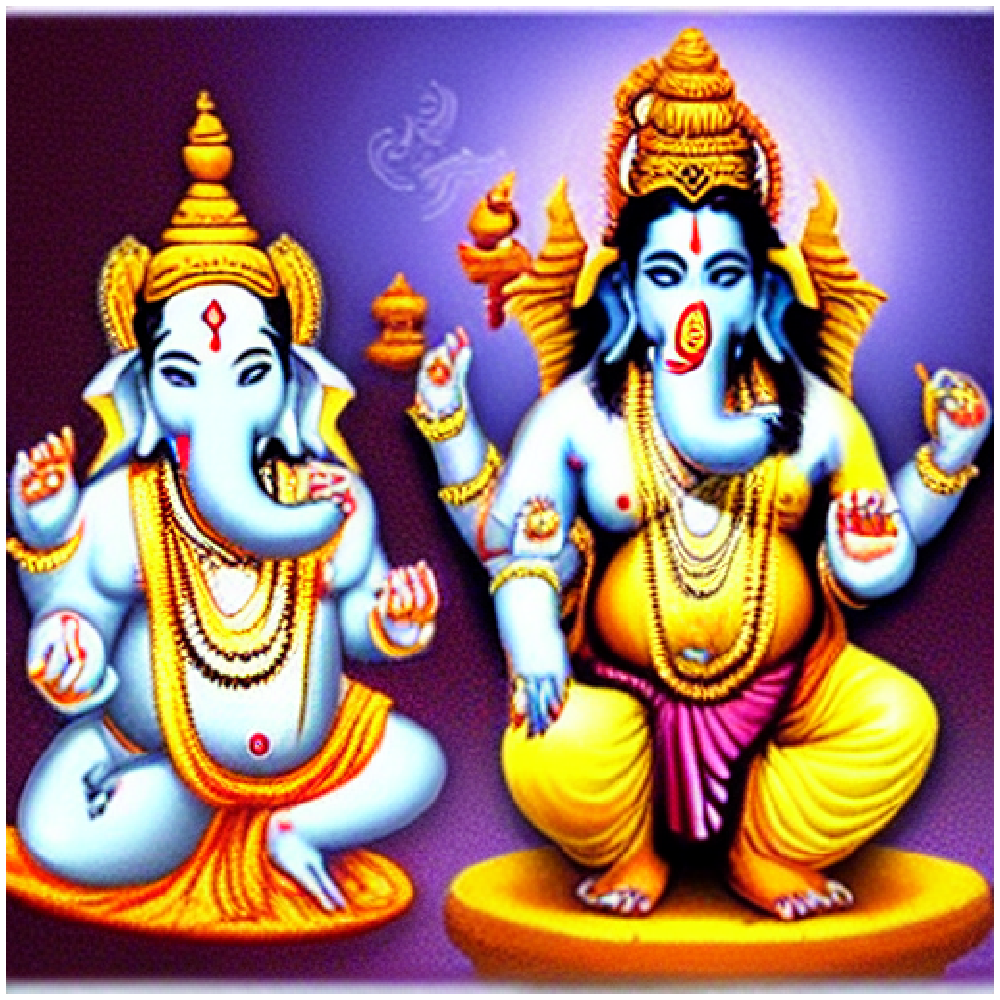

In [ ]:
images = model.text_to_image(
    "Lord Shiva with Lord Ganpati",
    batch_size=1,
)
plot_images(images)

50/50 [==============================] - 27s 439ms/step
XLA + mixed precision: 31.19 seconds


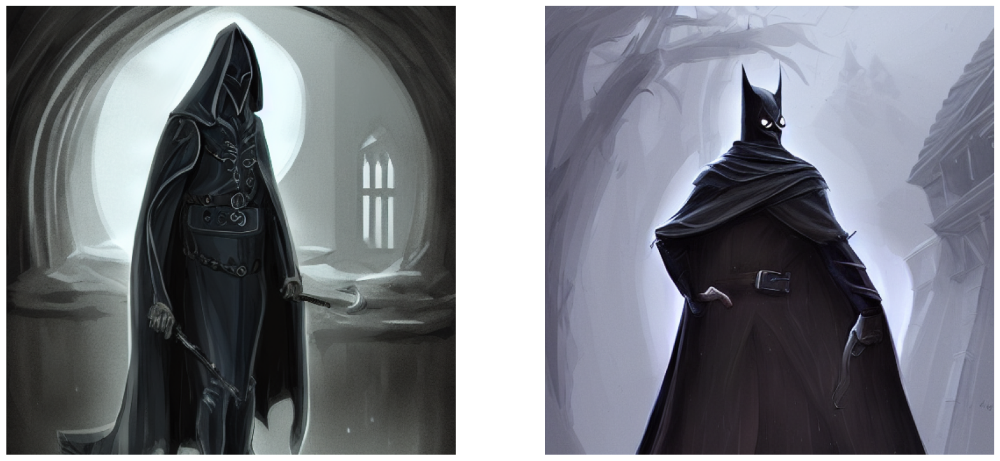

In [ ]:
start = time.time()
images = model.text_to_image(
    "A mysterious dark stranger visits the Hogwarts, "
    "high quality, highly detailed, elegant, sharp focus, "
    "concept art, character concepts, digital painting",
    batch_size=2,
)
end = time.time()
benchmark_result.append(["XLA + Mixed Precision", end - start])
plot_images(images)

print(f"XLA + mixed precision: {(end - start):.2f} seconds")

50/50 [==============================] - 23s 452ms/step
XLA + mixed precision: 23.19 seconds


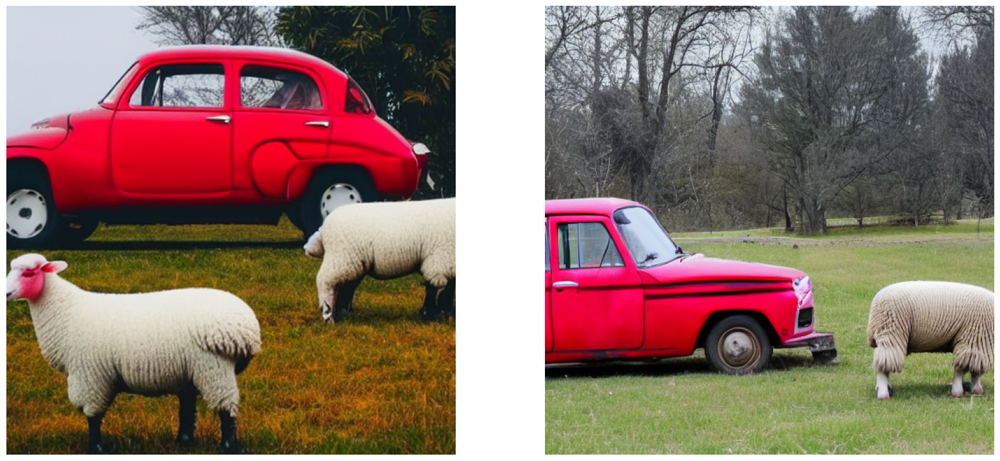

In [ ]:
start = time.time()
images = model.text_to_image(
    " A red car. A white sheep , "

    ,
    batch_size=2,
)
end = time.time()
benchmark_result.append(["XLA + Mixed Precision", end - start])
plot_images(images)

print(f"XLA + mixed precision: {(end - start):.2f} seconds")

50/50 [==============================] - 22s 447ms/step
XLA + mixed precision: 22.92 seconds


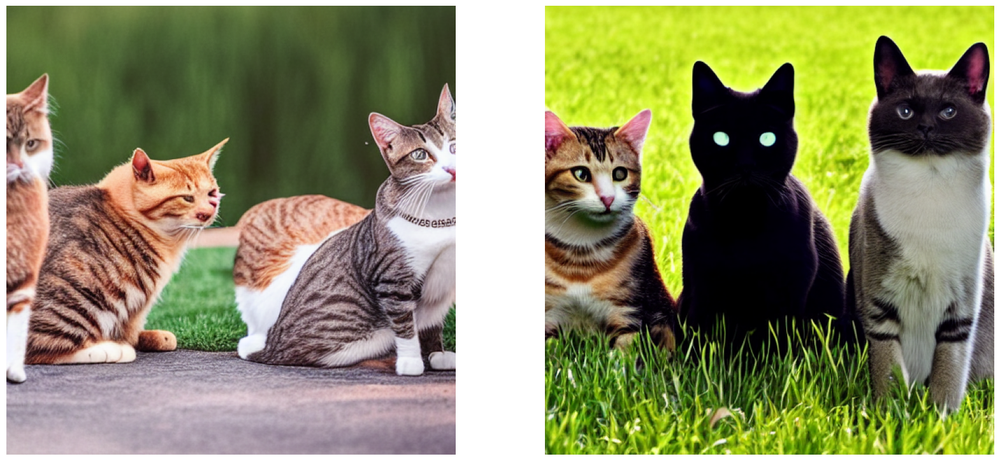

In [ ]:
start = time.time()
images = model.text_to_image(
    " Cats sit on the grass., "

    ,
    batch_size=2,
)
end = time.time()
benchmark_result.append(["XLA + Mixed Precision", end - start])
plot_images(images)

print(f"XLA + mixed precision: {(end - start):.2f} seconds")

50/50 [==============================] - 23s 461ms/step
XLA + mixed precision: 23.64 seconds


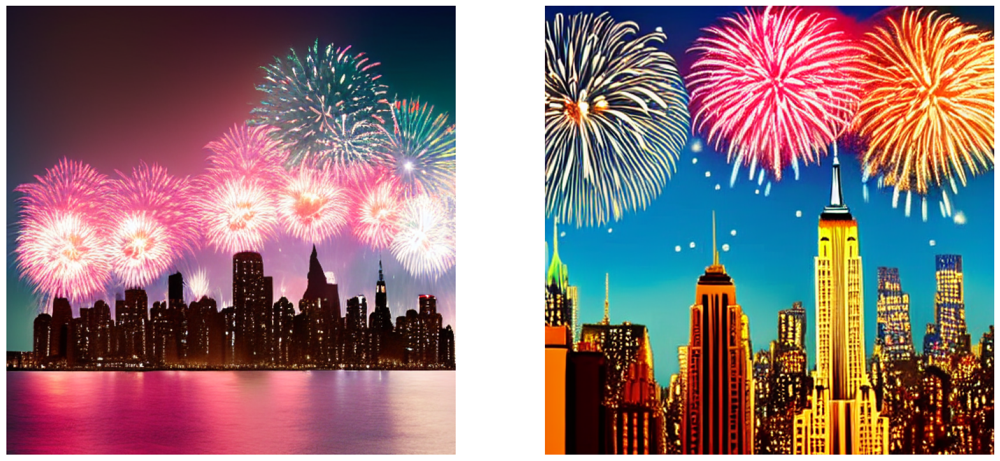

In [ ]:
start = time.time()
images = model.text_to_image(
    " New York skyline with fireworks., "

    ,
    batch_size=2,
)
end = time.time()
benchmark_result.append(["XLA + Mixed Precision", end - start])
plot_images(images)

print(f"XLA + mixed precision: {(end - start):.2f} seconds")

50/50 [==============================] - 15s 287ms/step
XLA + mixed precision: 14.97 seconds


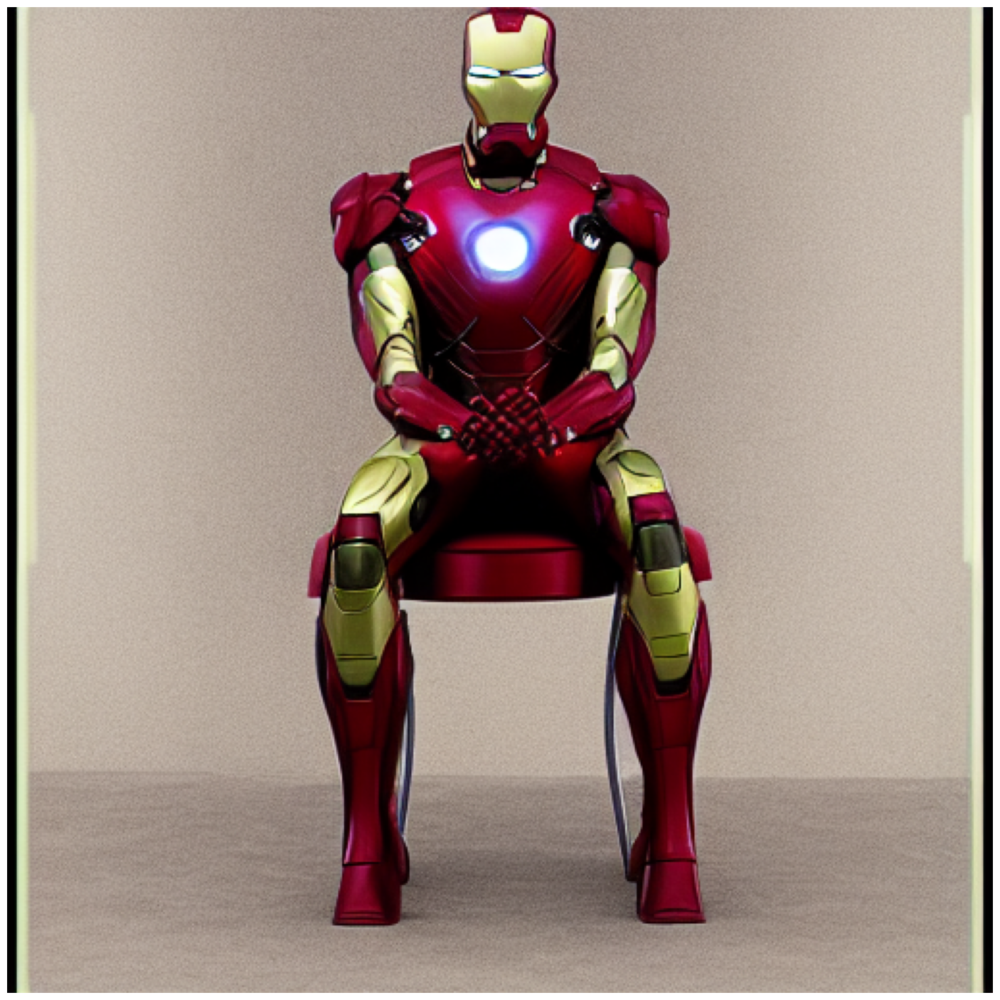

In [ ]:
start = time.time()
images = model.text_to_image(
    " Iron Man sitting on a chair, "
    ,
    batch_size=1,
)
end = time.time()
benchmark_result.append(["XLA + Mixed Precision", end - start])
plot_images(images)

print(f"XLA + mixed precision: {(end - start):.2f} seconds")

In [ ]:
start = time.time()
images = model.text_to_image(
    " A dog sitting on the grass."
    ,
    batch_size=1,
)
end = time.time()
benchmark_result.append(["XLA + Mixed Precision", end - start])
plot_images(images)

print(f"XLA + mixed precision: {(end - start):.2f} seconds")
start = time.time()
images = model.text_to_image(
    " Now the dog is playing with the ball"
    ,
    batch_size=1,
)
end = time.time()
benchmark_result.append(["XLA + Mixed Precision", end - start])
plot_images(images)

print(f"XLA + mixed precision: {(end - start):.2f} seconds")

50/50 [==============================] - 14s 286ms/step
XLA + mixed precision: 14.77 seconds
50/50 [==============================] - 15s 291ms/step
XLA + mixed precision: 14.85 seconds


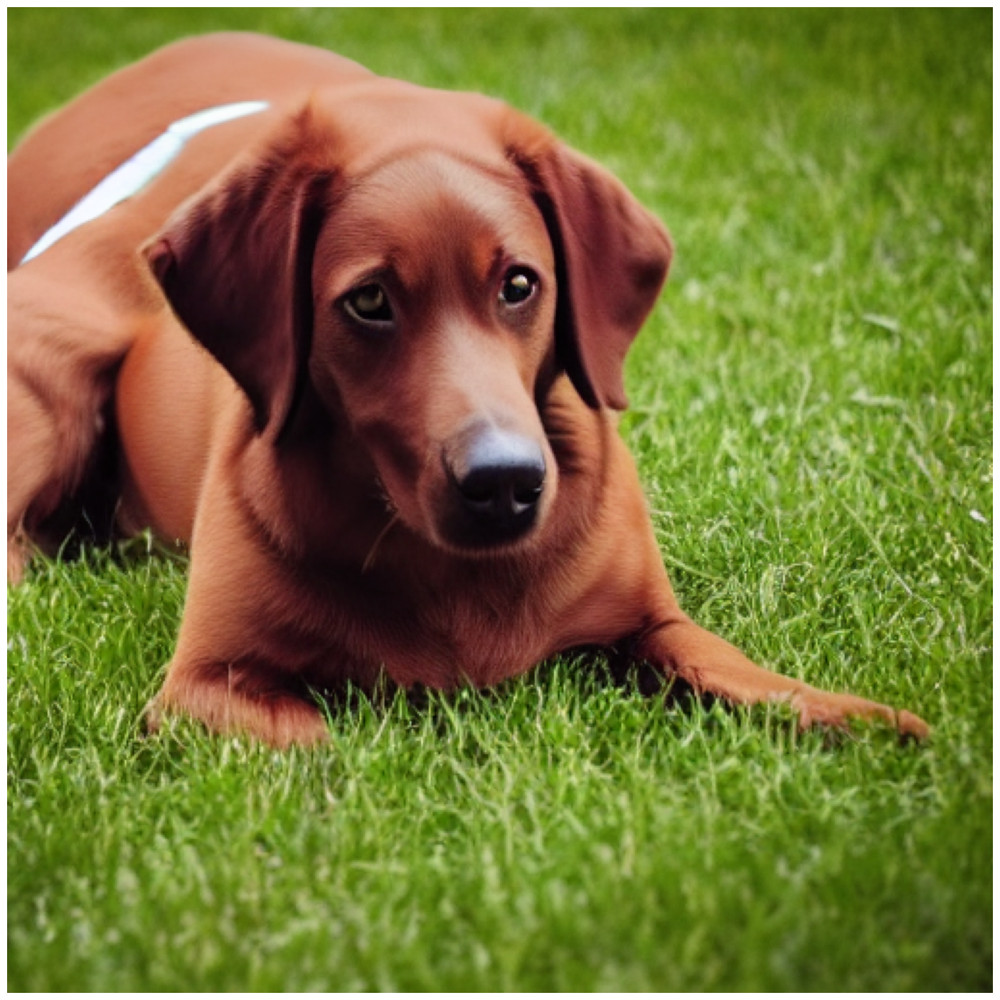

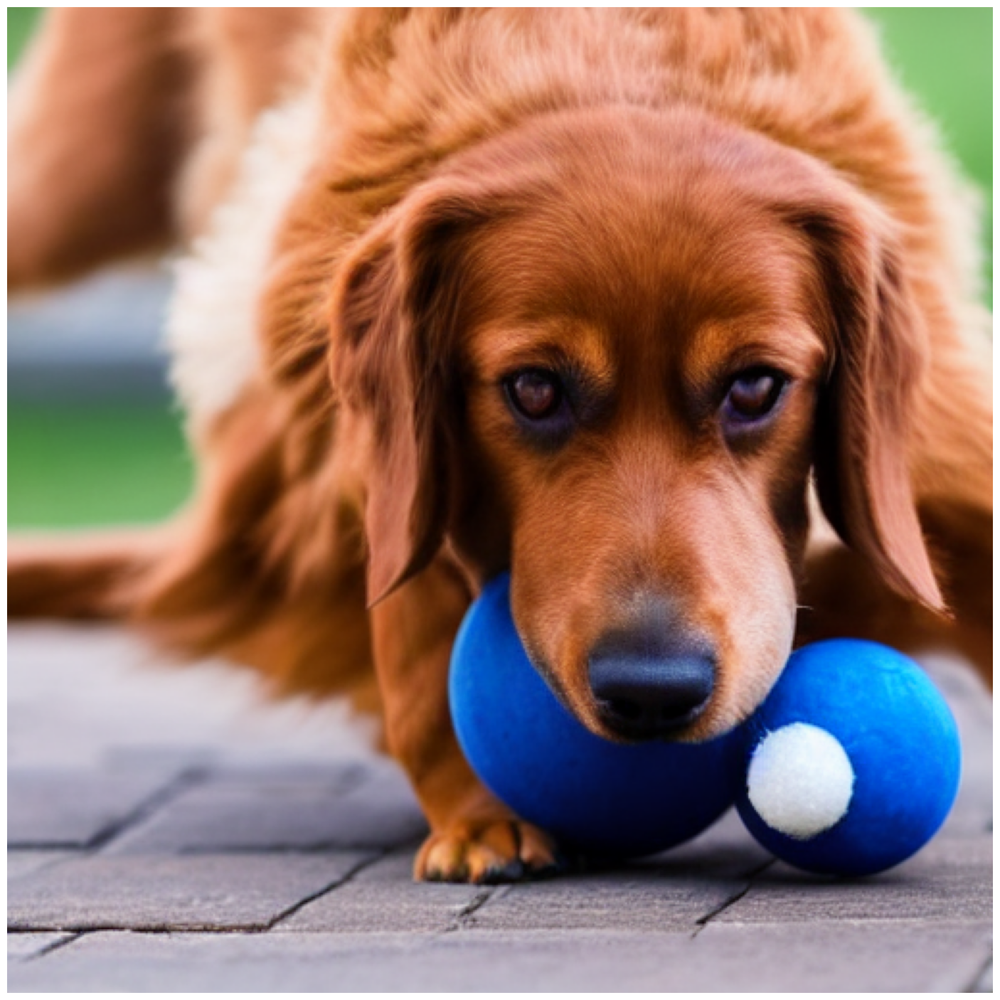

In [ ]:
start = time.time()
images = model.text_to_image(
    "A brown dog is sitting on the grass."
    ,
    batch_size=1,
)
end = time.time()
benchmark_result.append(["XLA + Mixed Precision", end - start])
plot_images(images)

print(f"XLA + mixed precision: {(end - start):.2f} seconds")
start = time.time()
images = model.text_to_image(
    "Now the brown dog is now playing with a ball."
    ,
    batch_size=1,
)
end = time.time()
benchmark_result.append(["XLA + Mixed Precision", end - start])
plot_images(images)

print(f"XLA + mixed precision: {(end - start):.2f} seconds")